<a href="https://colab.research.google.com/github/data-science-and-machine-learning/self-driving-car/blob/master/Self_driving_car.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

### Credits

In [0]:
# Credits: https://github.com/SullyChen/Autopilot-TensorFlow
# Research paper: End to End Learning for Self-Driving Cars by Nvidia. [https://arxiv.org/pdf/1604.07316.pdf]

# NVidia dataset: 72 hrs of video => 72*60*60*30 = 7,776,000 images
# Nvidia blog: https://devblogs.nvidia.com/deep-learning-self-driving-cars/


# Our Dataset: https://github.com/SullyChen/Autopilot-TensorFlow [https://drive.google.com/file/d/0B-KJCaaF7elleG1RbzVPZWV4Tlk/view]
# Size: 25 minutes = 25*60*30 = 45,000 images ~ 2.3 GB


# If you want to try on a slightly large dataset: 70 minutes of data ~ 223GB
# Refer: https://medium.com/udacity/open-sourcing-223gb-of-mountain-view-driving-data-f6b5593fbfa5
# Format: Image, latitude, longitude, gear, brake, throttle, steering angles and speed



# Additional Installations:
# pip3 install h5py


# AWS: https://aws.amazon.com/blogs/machine-learning/get-started-with-deep-learning-using-the-aws-deep-learning-ami/

# Youtube:https://www.youtube.com/watch?v=qhUvQiKec2U
# Further reading and extensions: https://medium.com/udacity/teaching-a-machine-to-steer-a-car-d73217f2492c
# More data: https://medium.com/udacity/open-sourcing-223gb-of-mountain-view-driving-data-f6b5593fbfa5

In [0]:
import numpy as np
a = np.array([[1,2,3],[3,4,5]])
print(a)
print(a[-1:])

[[1 2 3]
 [3 4 5]]
[[3 4 5]]


In [0]:
import scipy.misc
import imageio
# scipy.misc.imresize(scipy.misc.imread(train_xs[(train_batch_pointer + i) % num_train_images])[-150:], [66, 200]) / 255.0
# you can break the whole line into parts like this
# here (train_batch_pointer + i) % num_train_images => "% num_train_images" is used to make sure that the
# (train_batch_pointer + i) values should not cross number of train images.

# lets explain whats happening with the first images
image_read = imageio.imread(train_xs[0])
print("original image size",image_read.shape)

print("After taking the last 150 rows i.e lower part of the images where road is present, ",image_read[-150:].shape)
image_read = image_read[-150:]
resized_image = scipy.misc.imresize(image_read, [66, 200])
print("After resizing the images into 66*200, ",resized_image.shape)
# 200/66 = 455/150 = 3.0303 => we are keeping aspect ratio when we are resizing it

In [0]:
scipy.misc.imresize(scipy.misc.imread(train_xs[0])[-150:], [66, 200])

In [0]:
import scipy.misc
import random

xs = []
ys = []

#points to the end of the last batch
train_batch_pointer = 0
val_batch_pointer = 0

#read data.txt
with open("driving_dataset/data.txt") as f:
    for line in f:
        xs.append("driving_dataset/" + line.split()[0])
        #the paper by Nvidia uses the inverse of the turning radius,
        #but steering wheel angle is proportional to the inverse of turning radius
        #so the steering wheel angle in radians is used as the output
        ys.append(float(line.split()[1]) * scipy.pi / 180)

#get number of images
num_images = len(xs)


train_xs = xs[:int(len(xs) * 0.8)]
train_ys = ys[:int(len(xs) * 0.8)]

val_xs = xs[-int(len(xs) * 0.2):]
val_ys = ys[-int(len(xs) * 0.2):]

num_train_images = len(train_xs)
num_val_images = len(val_xs)

def LoadTrainBatch(batch_size):
    global train_batch_pointer
    x_out = []
    y_out = []
    for i in range(0, batch_size):
        x_out.append(scipy.misc.imresize(scipy.misc.imread(train_xs[(train_batch_pointer + i) % num_train_images])[-150:], [66, 200]) / 255.0)
        y_out.append([train_ys[(train_batch_pointer + i) % num_train_images]])
    train_batch_pointer += batch_size
    return x_out, y_out

def LoadValBatch(batch_size):
    global val_batch_pointer
    x_out = []
    y_out = []
    for i in range(0, batch_size):
        x_out.append(scipy.misc.imresize(scipy.misc.imread(val_xs[(val_batch_pointer + i) % num_val_images])[-150:], [66, 200]) / 255.0)
        y_out.append([val_ys[(val_batch_pointer + i) % num_val_images]])
    val_batch_pointer += batch_size
    return x_out, y_out


FileNotFoundError: ignored

In [0]:
import tensorflow as tf
import scipy

def weight_variable(shape):
  initial = tf.truncated_normal(shape, stddev=0.1)
  return tf.Variable(initial)

def bias_variable(shape):
  initial = tf.constant(0.1, shape=shape)
  return tf.Variable(initial)

def conv2d(x, W, stride):
  return tf.nn.conv2d(x, W, strides=[1, stride, stride, 1], padding='VALID')

x = tf.placeholder(tf.float32, shape=[None, 66, 200, 3])
y_ = tf.placeholder(tf.float32, shape=[None, 1])

x_image = x

#first convolutional layer
W_conv1 = weight_variable([5, 5, 3, 24])
b_conv1 = bias_variable([24])

h_conv1 = tf.nn.relu(conv2d(x_image, W_conv1, 2) + b_conv1)

#second convolutional layer
W_conv2 = weight_variable([5, 5, 24, 36])
b_conv2 = bias_variable([36])

h_conv2 = tf.nn.relu(conv2d(h_conv1, W_conv2, 2) + b_conv2)

#third convolutional layer
W_conv3 = weight_variable([5, 5, 36, 48])
b_conv3 = bias_variable([48])

h_conv3 = tf.nn.relu(conv2d(h_conv2, W_conv3, 2) + b_conv3)

#fourth convolutional layer
W_conv4 = weight_variable([3, 3, 48, 64])
b_conv4 = bias_variable([64])

h_conv4 = tf.nn.relu(conv2d(h_conv3, W_conv4, 1) + b_conv4)

#fifth convolutional layer
W_conv5 = weight_variable([3, 3, 64, 64])
b_conv5 = bias_variable([64])

h_conv5 = tf.nn.relu(conv2d(h_conv4, W_conv5, 1) + b_conv5)

#FCL 1
W_fc1 = weight_variable([1152, 1164])
b_fc1 = bias_variable([1164])

h_conv5_flat = tf.reshape(h_conv5, [-1, 1152])
h_fc1 = tf.nn.relu(tf.matmul(h_conv5_flat, W_fc1) + b_fc1)

rate=0.5 = tf.placeholder(tf.float32)
h_fc1_drop = tf.nn.dropout(h_fc1, rate=0.5)

#FCL 2
W_fc2 = weight_variable([1164, 100])
b_fc2 = bias_variable([100])

h_fc2 = tf.nn.relu(tf.matmul(h_fc1_drop, W_fc2) + b_fc2)

h_fc2_drop = tf.nn.dropout(h_fc2, rate=0.5)

#FCL 3
W_fc3 = weight_variable([100, 50])
b_fc3 = bias_variable([50])

h_fc3 = tf.nn.relu(tf.matmul(h_fc2_drop, W_fc3) + b_fc3)

h_fc3_drop = tf.nn.dropout(h_fc3, rate=0.5)

#FCL 3
W_fc4 = weight_variable([50, 10])
b_fc4 = bias_variable([10])

h_fc4 = tf.nn.relu(tf.matmul(h_fc3_drop, W_fc4) + b_fc4)

h_fc4_drop = tf.nn.dropout(h_fc4, rate=0.5)

#Output
W_fc5 = weight_variable([10, 1])
b_fc5 = bias_variable([1])

y = tf.multiply(tf.atan(tf.matmul(h_fc4_drop, W_fc5) + b_fc5), 2) #scale the atan output


D:\installed\Anaconda3\lib\site-packages\h5py\__init__.py:36: FutureWarning: Conversion of the second argument of issubdtype from `float` to `np.floating` is deprecated. In future, it will be treated as `np.float64 == np.dtype(float).type`.
  from ._conv import register_converters as _register_converters


### Start

In [1]:
from google.colab import drive
drive.mount('/content/drive')


Go to this URL in a browser: https://accounts.google.com/o/oauth2/auth?client_id=947318989803-6bn6qk8qdgf4n4g3pfee6491hc0brc4i.apps.googleusercontent.com&redirect_uri=urn%3Aietf%3Awg%3Aoauth%3A2.0%3Aoob&scope=email%20https%3A%2F%2Fwww.googleapis.com%2Fauth%2Fdocs.test%20https%3A%2F%2Fwww.googleapis.com%2Fauth%2Fdrive%20https%3A%2F%2Fwww.googleapis.com%2Fauth%2Fdrive.photos.readonly%20https%3A%2F%2Fwww.googleapis.com%2Fauth%2Fpeopleapi.readonly&response_type=code

Enter your authorization code:
··········
Mounted at /content/drive


In [2]:
# read images and steering angles from driving_dataset folder

from __future__ import division

import os
import numpy as np
import random

from scipy import pi
from itertools import islice



DATA_FOLDER = 'drive/My Drive/Autopilot-TensorFlow/Files' # change this to your folder
TRAIN_FILE = os.path.join(DATA_FOLDER, 'data.txt')
LIMIT= 45408

split =0.8
X = []
y = []
with open(TRAIN_FILE) as fp:
    for line in islice(fp, LIMIT):
        path, angle = line.strip().split()
        full_path = os.path.join(DATA_FOLDER, path)
        X.append(full_path)
        
        # converting angle from degrees to radians
        y.append(float(angle) * pi / 180 )

y = np.array(y)
print("Completed processing data.txt")

split_index = int(len(y)*0.8)

train_y = y[:split_index]
test_y = y[split_index:]


Completed processing data.txt


In [0]:
!cd drive/My\ Drive/Autopilot-TensorFlow/driving_dataset/driving_dataset
#!find . | wc -l


/usr/local/lib/python3.6/dist-packages/matplotlib/axes/_axes.py:6521: MatplotlibDeprecationWarning: 
The 'normed' kwarg was deprecated in Matplotlib 2.1 and will be removed in 3.1. Use 'density' instead.
  alternative="'density'", removal="3.1")


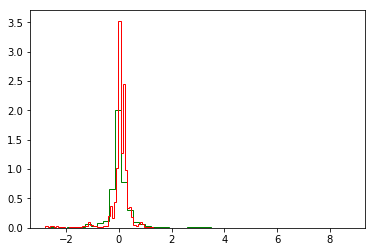

In [3]:
import numpy;

# PDF of train and test 'y' values. 
import matplotlib.pyplot as plt 
plt.hist(train_y, bins=50, normed=1, color='green', histtype ='step');
plt.hist(test_y, bins=50, normed=1, color='red', histtype ='step');
plt.show()




In [4]:
#Model 0: Base line Model: y_test_pred = mean(y_train_i) 
train_mean_y = np.mean(train_y)

print('Test_MSE(MEAN):%f' % np.mean(np.square(test_y-train_mean_y)) )

print('Test_MSE(ZERO):%f' % np.mean(np.square(test_y-0.0)) )


Test_MSE(MEAN):0.191127
Test_MSE(ZERO):0.190891


#### Train code

In [5]:
#!kill -9 -1
!nvidia-smi

Mon Sep  2 05:05:35 2019       
+-----------------------------------------------------------------------------+
| NVIDIA-SMI 430.40       Driver Version: 418.67       CUDA Version: 10.1     |
|-------------------------------+----------------------+----------------------+
| GPU  Name        Persistence-M| Bus-Id        Disp.A | Volatile Uncorr. ECC |
| Fan  Temp  Perf  Pwr:Usage/Cap|         Memory-Usage | GPU-Util  Compute M. |
|===============================+======================+======================|
|   0  Tesla T4            Off  | 00000000:00:04.0 Off |                    0 |
| N/A   29C    P8     9W /  70W |      0MiB / 15079MiB |      0%      Default |
+-------------------------------+----------------------+----------------------+
                                                                               
+-----------------------------------------------------------------------------+
| Processes:                                                       GPU Memory |
|  GPU  

In [0]:
!unzip /content/drive/My\ Drive/driving_dataset.zip -d driving_dataset

In [11]:
import sys
sys.path.append("/content/drive/My Drive/Autopilot-TensorFlow/Files")
import model
import driving_data
import os
import tensorflow as tf
from tensorflow.core.protobuf import saver_pb2
from datetime import datetime #import time
#import #import model
#%load_ext tensorboard 
#%tensorboard --logdir=./logs 


LOGDIR = './save'

sess = tf.InteractiveSession()

L2NormConst = 0.001

train_vars = tf.trainable_variables()

loss = tf.reduce_mean(tf.square(tf.subtract(model.y_, model.y))) + tf.add_n([tf.nn.l2_loss(v) for v in train_vars]) * L2NormConst
train_step = tf.train.AdamOptimizer(1e-3).minimize(loss)
sess.run(tf.global_variables_initializer())

# create a summary to monitor cost tensor
tf.summary.scalar("loss", loss)
# merge all summaries into a single op
merged_summary_op =  tf.summary.merge_all()

saver = tf.train.Saver(write_version = saver_pb2.SaverDef.V1)

# op to write logs to Tensorboard
logs_path = './logs'
summary_writer = tf.summary.FileWriter(logs_path, graph=tf.get_default_graph())

epochs = 30
batch_size = 1000
#print("num_images=", num_images)
# train over the dataset about 30 times
start_time = datetime.now()

print(start_time, driving_data.num_images/batch_size)

for epoch in range(epochs):
  
  for i in range(int(driving_data.num_images/batch_size)):
    print("\repoch, batch_size, i= ", epoch, batch_size, i, end= '')
    xs, ys = driving_data.LoadTrainBatch(batch_size)
    #print("batch loaded" , i, end= '')
    train_step.run(feed_dict={model.x: xs, model.y_: ys, model.keep_prob: 0.5})
    if i % 10 == 0:
      xs, ys = driving_data.LoadValBatch(batch_size)
      loss_value = loss.eval(feed_dict={model.x:xs, model.y_: ys, model.keep_prob: 0.5})
      end_time = datetime.now()
      print("Epoch: %d, Step: %d, Loss: %g, time taken: " % (epoch, epoch * batch_size + i, loss_value), end_time-start_time)
      start_time = datetime.now()
    # write logs at every iteration
    summary = merged_summary_op.eval(feed_dict={model.x:xs, model.y_: ys, model.keep_prob: 0.5})
    summary_writer.add_summary(summary, epoch * driving_data.num_images/batch_size + i)

    if i % batch_size == 0:
      if not os.path.exists(LOGDIR):
        os.makedirs(LOGDIR)
      checkpoint_path = os.path.join(LOGDIR, "model.ckpt")
      filename = saver.save(sess, checkpoint_path)

print("Run the command line:\n" \
          "--> tensorboard --logdir=./logs " \
          "\nThen open http://0.0.0.0:6006/ into your web browser")


/usr/local/lib/python3.6/dist-packages/tensorflow/python/client/session.py:1735: UserWarning: An interactive session is already active. This can cause out-of-memory errors in some cases. You must explicitly call `InteractiveSession.close()` to release resources held by the other session(s).
  warnings.warn('An interactive session is already active. This can '


2019-09-01 09:23:32.481027 45.406
epoch, batch_size, i=  0 1000 0Epoch: 0, Step: 0, Loss: 6.86564, time taken:  0:00:06.432830
epoch, batch_size, i=  0 1000 10Epoch: 0, Step: 10, Loss: 5.60034, time taken:  0:00:39.049610
epoch, batch_size, i=  0 1000 20Epoch: 0, Step: 20, Loss: 5.21158, time taken:  0:00:39.582412
epoch, batch_size, i=  0 1000 30Epoch: 0, Step: 30, Loss: 4.83953, time taken:  0:00:39.457454
epoch, batch_size, i=  0 1000 40Epoch: 0, Step: 40, Loss: 4.3233, time taken:  0:00:38.847818
epoch, batch_size, i=  1 1000 0Epoch: 1, Step: 1000, Loss: 3.72795, time taken:  0:00:21.372662
epoch, batch_size, i=  1 1000 10Epoch: 1, Step: 1010, Loss: 3.51367, time taken:  0:00:39.993401
epoch, batch_size, i=  1 1000 20Epoch: 1, Step: 1020, Loss: 2.93368, time taken:  0:00:38.899206
epoch, batch_size, i=  1 1000 30Epoch: 1, Step: 1030, Loss: 3.13549, time taken:  0:00:40.054852
epoch, batch_size, i=  1 1000 40Epoch: 1, Step: 1040, Loss: 2.30944, time taken:  0:00:38.815733
epoch, bat

In [15]:
checkpoint_path = os.path.join('drive/My Drive/Autopilot-TensorFlow/myModel', "model.ckpt")
filename = saver.save(sess, checkpoint_path)


W0901 10:52:50.303284 140406775838592 saver.py:1134] *******************************************************
W0901 10:52:50.305869 140406775838592 saver.py:1135] TensorFlow's V1 checkpoint format has been deprecated.
W0901 10:52:50.306876 140406775838592 saver.py:1136] Consider switching to the more efficient V2 format:
W0901 10:52:50.307746 140406775838592 saver.py:1137]    `tf.train.Saver(write_version=tf.train.SaverDef.V2)`
W0901 10:52:50.309397 140406775838592 saver.py:1138] now on by default.
W0901 10:52:50.310232 140406775838592 saver.py:1139] *******************************************************


In [16]:
#import #import model
%load_ext tensorboard 
%tensorboard --logdir=./logs 

#### Running code

/usr/local/lib/python3.6/dist-packages/tensorflow/python/client/session.py:1735: UserWarning: An interactive session is already active. This can cause out-of-memory errors in some cases. You must explicitly call `InteractiveSession.close()` to release resources held by the other session(s).
  warnings.warn('An interactive session is already active. This can '


45406
36325
  36576  

<Figure size 360x360 with 0 Axes>

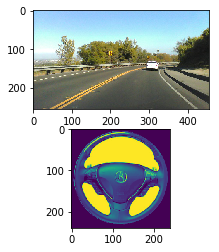

In [13]:
%matplotlib inline
import sys
sys.path.append("/content/drive/My Drive/Autopilot-TensorFlow/Files")
import numpy as np
import matplotlib.pyplot as plt
import tensorflow as tf
import scipy.misc
import cv2
import math
import imageio
import matplotlib.pyplot as plt
import matplotlib.animation as animation
import matplotlib
from matplotlib import rc
import numpy as np
from PIL import Image
from IPython.display import HTML
from matplotlib import animation, rc
from IPython.display import HTML
import driving_data
import model

#x, y, y_, rate= create_model()
session = tf.InteractiveSession()
#tf.reset_default_graph()
saver = tf.train.Saver(allow_empty=True)
saver.restore(session, "drive/My Drive/Autopilot-TensorFlow/myModel/model.ckpt")


xs = []
ys = []
img = cv2.imread('drive/My Drive/Autopilot-TensorFlow/Files/steering_wheel_image.jpg',0)
rows,cols = img.shape

with open("drive/My Drive/Autopilot-TensorFlow/Files/data.txt") as f:
  for line in f:
    xs.append("driving_dataset/driving_dataset" + line.split()[0])
    ys.append(float(line.split()[1]) * scipy.pi / 180)

#get number of images
driving_data.num_images = len(xs)
print(driving_data.num_images)
#fig, ax1 = plt.subplots()

i = math.ceil(driving_data.num_images*0.8)
print(i)

fig= plt.figure(figsize= (5,5))
fig, (ax1,ax2) = plt.subplots(2, 1)

smoothed_angle=0

def f(i):
  full_image= imageio.imread("driving_dataset/driving_dataset/" + str(i) + ".jpg")
  #image = np.array(Image.fromarray(imageio.imread(full_image[-150:], [66, 200]).resize()), dtype= float) / 255.0
  return full_image

def g(i):
  global smoothed_angle
  full_image= "driving_dataset/driving_dataset/" + str(i) + ".jpg"
  image = np.array(Image.fromarray(imageio.imread(full_image)[-150:]).resize([200, 66]), dtype=float) / 255.0
  degrees = model.y.eval(feed_dict={model.x: [image], model.keep_prob: 0.5})[0][0] * 180.0 / scipy.pi
  smoothed_angle += 0.2 * pow(abs((degrees - smoothed_angle)), 2.0 / 3.0) * (degrees - smoothed_angle) / abs(degrees - smoothed_angle)

  M = cv2.getRotationMatrix2D((cols/2,rows/2),-smoothed_angle,1)
  dst = cv2.warpAffine(img,M,(cols,rows))
  return dst

im = ax1.imshow(f(i), animated=True)
im2= ax2.imshow(g(i), animated=True)
def updatefig(*args):
    global i
    print("\r  {}  ".format(i), end="")
    i+=1
    im.set_array(f(i))
    im2.set_array(g(i))
    return im, im2

anim = animation.FuncAnimation(fig, updatefig, frames= 250, interval=100, blit=True)
# Note: below is the part which makes it work on Colab
matplotlib.rcParams['animation.embed_limit'] = 2**128
rc('animation', html='jshtml')
anim
#plt.show()


In [0]:
ax1.figure.set_size_inches(5,3)
anim

In [0]:
#pip3 install opencv-python

import tensorflow as tf
import scipy.misc
#import model
import cv2
from subprocess import call
import math

sess = tf.InteractiveSession()
saver = tf.train.Saver()
saver.restore(sess, "drive/My\ Drive/Autopilot-TensorFlow/save/model.ckpt")

img = cv2.imread('steering_wheel_image.jpg',0)
rows,cols = img.shape

smoothed_angle = 0


#read data.txt
xs = []
ys = []
with open("driving_dataset/data.txt") as f:
    for line in f:
        xs.append("driving_dataset/" + line.split()[0])
        #the paper by Nvidia uses the inverse of the turning radius,
        #but steering wheel angle is proportional to the inverse of turning radius
        #so the steering wheel angle in radians is used as the output
        ys.append(float(line.split()[1]) * scipy.pi / 180)

#get number of images
num_images = len(xs)


i = math.ceil(num_images*0.8)
print("Starting frameofvideo:" +str(i))

while(cv2.waitKey(10) != ord('q')):
    full_image = scipy.misc.imread("driving_dataset/" + str(i) + ".jpg", mode="RGB")
    image = scipy.misc.imresize(full_image[-150:], [66, 200]) / 255.0
    degrees = model.y.eval(feed_dict={model.x: [image], model.rate=0.5: 1.0})[0][0] * 180.0 / scipy.pi
    #call("clear")
    #print("Predicted Steering angle: " + str(degrees))
    print("Steering angle: " + str(degrees) + " (pred)\t" + str(ys[i]*180/scipy.pi) + " (actual)")
    cv2.imshow("frame", cv2.cvtColor(full_image, cv2.COLOR_RGB2BGR))
    #make smooth angle transitions by turning the steering wheel based on the difference of the current angle
    #and the predicted angle
    smoothed_angle += 0.2 * pow(abs((degrees - smoothed_angle)), 2.0 / 3.0) * (degrees - smoothed_angle) / abs(degrees - smoothed_angle)
    M = cv2.getRotationMatrix2D((cols/2,rows/2),-smoothed_angle,1)
    dst = cv2.warpAffine(img,M,(cols,rows))
    cv2.imshow("steering wheel", dst)
    i += 1

cv2.destroyAllWindows()


/usr/local/lib/python3.6/dist-packages/tensorflow/python/client/session.py:1735: UserWarning: An interactive session is already active. This can cause out-of-memory errors in some cases. You must explicitly call `InteractiveSession.close()` to release resources held by the other session(s).
  warnings.warn('An interactive session is already active. This can '


NotFoundError: ignored

In [0]:
%matplotlib inline
anim
plt.show()